#1) Setup environment

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!nvidia-smi -L
print("\n")
!head -n 2 /etc/*release

GPU 0: Tesla T4 (UUID: GPU-04c11efd-1a56-8b5a-347e-2b2d8550786b)


==> /etc/lsb-release <==
DISTRIB_ID=Ubuntu
DISTRIB_RELEASE=22.04

==> /etc/os-release <==
PRETTY_NAME="Ubuntu 22.04.2 LTS"
NAME="Ubuntu"


In [ ]:
!git clone https://github.com/ultralytics/ultralytics
!pip install ultralytics

Cloning into 'ultralytics'...
remote: Enumerating objects: 15551, done.
remote: Counting objects: 100% (184/184), done.
remote: Compressing objects: 100% (120/120), done.
remote: Total 15551 (delta 95), reused 124 (delta 64), pack-reused 15367
Receiving objects: 100% (15551/15551), 8.36 MiB | 13.68 MiB/s, done.
Resolving deltas: 100% (10732/10732), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 613.6/613.6 kB 5.8 MB/s eta 0:00:00


#2) Data preprocess

In [ ]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import PIL
import cv2
import random

import seaborn as sns

In [ ]:
train_path = "/content/drive/MyDrive/dataset_v1v2v3_merge/train/"
test_path = "/content/drive/MyDrive/dataset_v1v2v3_merge/test/"
valid_path = "/content/drive/MyDrive/dataset_v1v2v3_merge/valid/"

print(f'train images : {len(os.listdir(train_path))/2}')
print(f'test images : {len(os.listdir(test_path))/2}')
print(f'val images : {len(os.listdir(valid_path))/2}')

train images : 628.0
test images : 78.0
val images : 79.0


In [ ]:

def class_split(source_path, class_names):
    total_classes = 0
    files = os.listdir(source_path)
    l_counter = [0] * len(class_names)
    l_lists = []

    for file in files:
        with open(os.path.join(source_path, file), 'r') as f:
            for line in f:
                label, _, _, _, _ = line.split()
                label = int(label)

                l_counter[label] += 1

                if label not in l_lists:
                    l_lists.append(label)

                if label > total_classes:
                    total_classes = label

    return l_counter






In [ ]:
class_names =  ['start_page', 'ok', 'finish', 'next', 'accept','battle', 'battle_start',
        'change_party', 'claim', 'close', 'edit_party', 'event', 'finger_down',
        'free', 'home', 'league_battle', 'loading', 'login', 'player_name', 'skip',
        'tutorial', 'char_upg', 'punch', 'combat', 'commend',  'battle_loading',
        'password', 'profile', 'share_contact', 'scout', 'video_close',
        'already_claimed', 'dodge', 'skill_2', 'skill_1', 'homescreen',
        'hero_details', 'item_chance', 'continue_play', 'menu', 'exchange', 'connection_error']
len(class_names)

42

In [ ]:
import os

annotations_folder = train_path

class_counts = {}

# Iterate through all files in the annotations folder
for filename in os.listdir(annotations_folder):
    if filename.endswith(".txt"):
        annotations_file = os.path.join(annotations_folder, filename)

        with open(annotations_file, 'r') as file:
            lines = file.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) > 0:
                    class_id = int(parts[0])
                    if class_id in class_counts:
                        class_counts[class_id] += 1
                    else:
                        class_counts[class_id] = 1

class_data_list =  []

for class_id, count in class_counts.items():
    class_data_dict = {}
    class_data_dict['class_id'] = class_id
    class_data_dict['class_name'] = class_names[class_id]
    class_data_dict['class_count'] = count
    class_data_list.append(class_data_dict)

class_data_df = pd.DataFrame(class_data_list)
class_data_df.sort_values(by='class_id', ascending = True,  inplace=True)

class_data_df

,class_id,class_name,class_count
4,0,start_page,16
1,1,ok,53
33,2,finish,9
0,3,next,24
13,4,accept,29
38,5,battle,6
36,6,battle_start,9
28,7,change_party,9
23,8,claim,5
25,9,close,20


In [ ]:
source_path = train_path

all_files = os.listdir(source_path)
text_files = [files for files in all_files if files.endswith('.txt')]

data_list = []

for text_file in text_files:
    text_file_path = os.path.join(source_path, text_file)
    #print(text_file_path)
    with open(text_file_path, 'r') as file:
        for line in file:
            parts = line.strip().split()
            #print(line)
            data_dict = {}
            data_dict['file_name'] = text_file_path.split('/')[-1]
            data_dict['object_count'] = int(round(len(parts) / 5, 0))
            data_dict['class_index'] = int(parts[0])
            data_dict['class_name'] = class_names[int(parts[0])]
            data_dict['x'], data_dict['y'], data_dict['w'], data_dict['h'] = map(float, parts[1:5])
            data_list.append(data_dict)

df = pd.DataFrame(data_list)
df.sort_values(by='class_index', ascending = True,  inplace=True)

df.head(10)

,file_name,object_count,class_index,class_name,x,y,w,h
572,scimage1693350581.589715.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
46,scimage1693350494.50469.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
258,scimage1693368451.6440744.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
74,scimage1693350188.8394282.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
130,scimage1693350559.860579.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
325,scimage1693350483.8402965.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
606,scimage1693349983.7946446.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
389,scimage1693350547.2278285.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
16,scimage1693350576.0999386.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191
585,scimage1693350471.3766682.txt,1,0,start_page,0.525768,0.915003,0.139254,0.145191


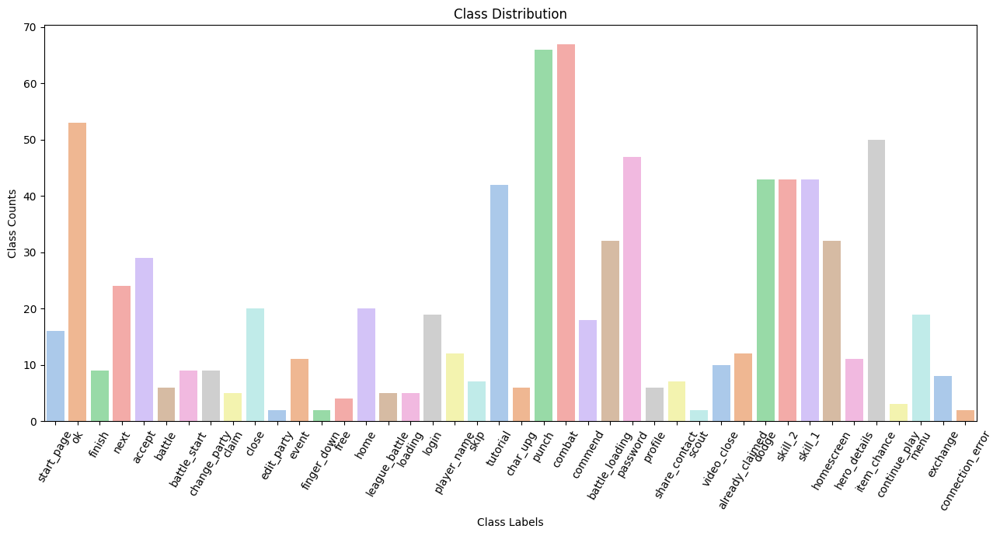

In [ ]:
plt.figure(figsize=(13, 7))
sns.barplot(x='class_name', y='class_count', data=class_data_df, palette='pastel')
plt.xlabel('Class Labels')
plt.ylabel('Class Counts')
plt.title('Class Distribution')
plt.xticks(rotation=60)
plt.tight_layout()
plt.show()


In [ ]:
random_file = random.choice(os.listdir(train_path))

if random_file.endswith(".txt"):
  image_name = random_file.split('.txt')[0] + ".jpeg"
  label_name = random_file
else:
  image_name = random_file
  label_name = random_file.split('.jpeg')[0] + ".txt"
random_file, image_name, label_name

('345.jpeg', '345.jpeg', '345.txt')

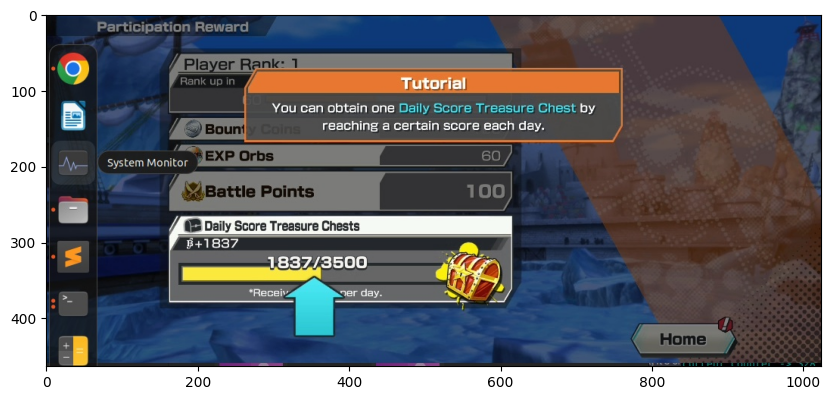

In [ ]:
img = cv2.imread(os.path.join(train_path, image_name), cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,7))
plt.imshow(img)

In [ ]:
H,W = img.shape[:2]
img.shape,H, W

((464, 1024, 3), 464, 1024)

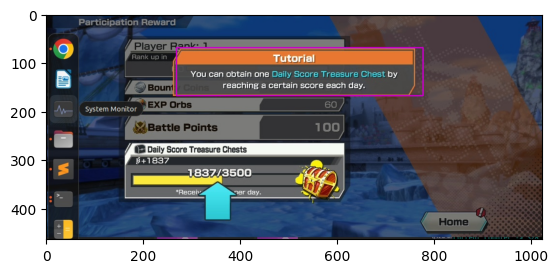

In [ ]:
H,W = img.shape[:2]
img.shape,H, W
with open(os.path.join(train_path,label_name), 'r') as f:
    while f:
        line = f.readline()
        if line == "":
            break
        label, x, y, w, h = line.split()
        label, x, y, w, h = (int(label), float(x), float(y), float(w), float(h))

        x1, y1, x2, y2 = (x-w/2, y-h/2, x+w/2, y+h/2)
        x1, y1, x2, y2 = (int(x1*W), int(y1*H), int(x2*W), int(y2*H))
        img = cv2.rectangle(img, (x1, y1), (x2,y2), (200,0,200), 2)
plt.imshow(img)


#3) Training on custom data

In [ ]:
from ultralytics import YOLO
import torch

In [ ]:
torch.__version__

'2.0.1+cu118'

In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.169 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.4/78.2 GB disk)


In [ ]:
torch.cuda.is_available()

True

In [ ]:
#https://docs.ultralytics.com/models/yolov8/#supported-modes

yolov8n_link = "https://github.com/ultralytics/assets/releases/download/v0.0.0/yolov8n.pt"
yolov8s_link = "https://github.com/ultralytics/assets/releases/download/v0.0.0/yolov8s.pt"

yolov8n_path = "/content/drive/MyDrive/yolov8n.pt"
yolov8s_path = "/content/drive/MyDrive/yolov8s.pt"



if os.path.exists(yolov8n_path):
    print("yolov8n.pt is available in drive!")
else:
    print("yolov8n.pt not available in drive, downloading!")
    !wget -P /content/drive/MyDrive/ $yolov8n_link


if os.path.exists(yolov8s_path):
    print("yolov8s.pt is available in drive!")
else:
    print("yolov8s.pt not available in drive, downloading!")
    !wget -P /content/drive/MyDrive/ $yolov8s_link

yolov8n.pt is available in drive!
yolov8s.pt is available in drive!


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/runs/detect

<IPython.core.display.Javascript object>

In [ ]:
train_run_name = "YOLOv8n_1024_batch32_epochs200_v3" #@param {type: "string"}
yaml_path = "/content/drive/MyDrive/dataset_v1v2v3_merge/data.yaml"

#@markdown ---

image_size = 1024 #@param {type: "integer"}
batch_size = 32 #@param {type:"slider", min:16, max:128, step:16}
number_epochs = 200 #@param {type:"slider", min:10, max:600, step:10}
model = yolov8n_path # @param ["yolov8n_path", "yolov8s_path"]


%cd /content
!yolo detect train \
name={train_run_name} \
imgsz={image_size} \
batch={batch_size} \
epochs={number_epochs} \
data= {yaml_path} \
model={model} \
patience=0 # disable EarlyStopping (default: 50)



/content
Ultralytics YOLOv8.0.169 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/yolov8n.pt, data=/content/drive/MyDrive/dataset_v1v2v3_merge/data.yaml, epochs=200, patience=0, batch=32, imgsz=1024, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=YOLOv8n_1024_batch32_epochs200_v3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=Fa

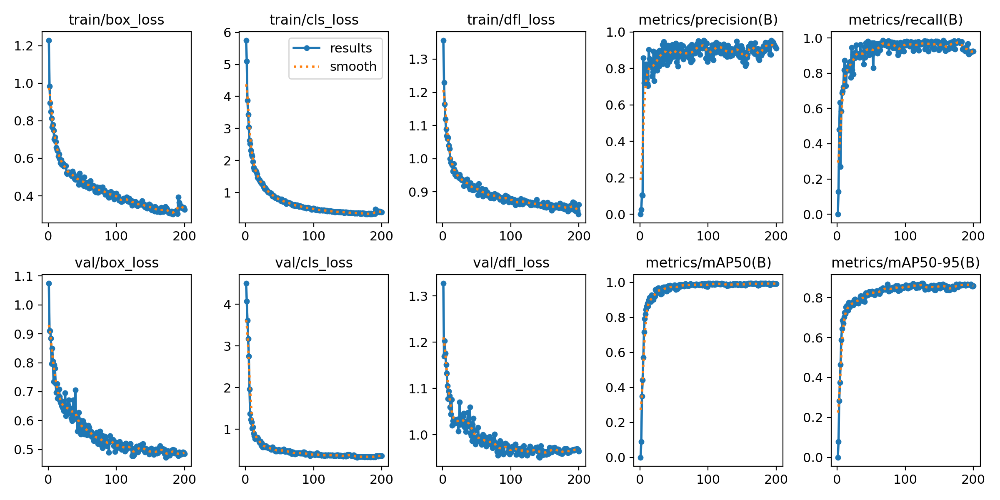

In [ ]:
from IPython.display import Image
Image(filename = f"/content/runs/detect/YOLOv8n_1024_batch32_epochs200_v3/results.png", width=1000)

#4) Validate

In [ ]:
%cd /content

!yolo detect val \
name={train_run_name}_validate \
model=/content/runs/detect/{train_run_name}/weights/best.pt \
data={yaml_path} \
imgsz={image_size} \
#split=test

/content
Ultralytics YOLOv8.0.169 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3013838 parameters, 0 gradients
val: Scanning /content/drive/MyDrive/dataset_v1v2v3_merge/valid.cache... 79 images, 0 backgrounds, 0 corrupt: 100% 79/79 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 5/5 [00:03<00:00,  1.45it/s]
                   all         79         94      0.893      0.974      0.987      0.866
            start_page         79          5      0.941          1      0.995      0.875
                    ok         79          6      0.967          1      0.995      0.609
                finish         79          1      0.771          1      0.995      0.697
                  next         79          2      0.908          1      0.995      0.846
                accept         79          5      0.938          1      0.995      0.911
          change_party         79       

#5) Predict

In [ ]:
pred_files = 5
test_files = os.listdir(test_path)

test_file = [files for files in test_files if files.endswith(".jpeg")]

for counter in range(pred_files):
  random_image_file = random.choice(test_file)
  random_image_file = os.path.join(test_path,random_image_file)
  print(f"file name is {random_image_file}")
  print(test_path)

file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693394514.1287928.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693393539.468432.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693364586.3293157.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693356650.6710289.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/254.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/


## Method 1

file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/389.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693356606.0732696.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693363448.3817997.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/scimage1693394181.7066998.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/
file name is /content/drive/MyDrive/dataset_v1v2v3_merge/test/122.jpeg
/content/drive/MyDrive/dataset_v1v2v3_merge/test/


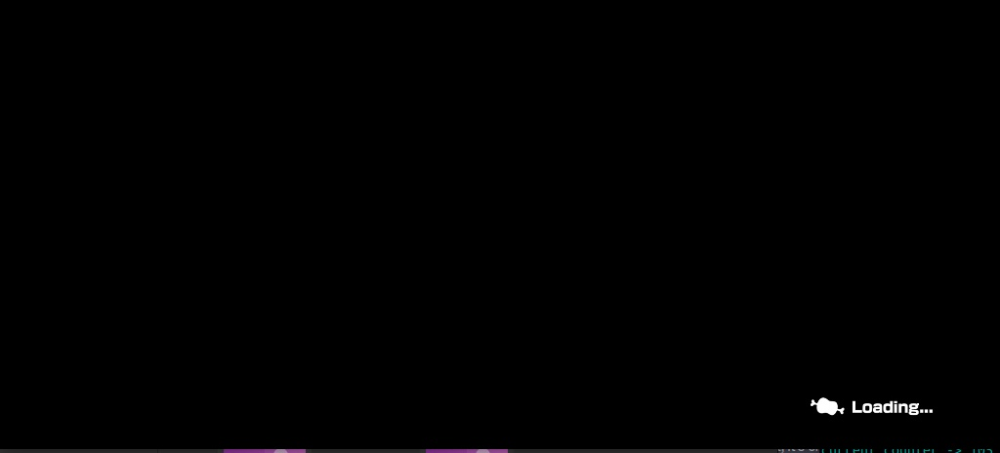

Ultralytics YOLOv8.0.169 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3013838 parameters, 0 gradients

image 1/1 /content/drive/MyDrive/dataset_v1v2v3_merge/test/122.jpeg: 480x1024 1 loading, 90.4ms
Speed: 3.0ms preprocess, 90.4ms inference, 93.1ms postprocess per image at shape (1, 3, 480, 1024)
Results saved to runs/detect/predict11


FileNotFoundError: ignored

FileNotFoundError: ignored

<IPython.core.display.Image object>

In [ ]:
pred_files = 5
test_files = os.listdir(test_path)

test_file = [files for files in test_files if files.endswith(".jpeg")]

for counter in range(pred_files):
  random_image_file = random.choice(test_file)
  random_image_file = os.path.join(test_path,random_image_file)
  print(f"file name is {random_image_file}")
  print(test_path)
from IPython.display import Image, display
from ultralytics import YOLO

best_model_path = "/content/runs/detect/YOLOv8n_1024_batch32_epochs200_v3/weights/best.pt"
pred_files = 1
opbr_model = YOLO(best_model_path)

for counter in range(pred_files):
  display(Image(random_image_file))
  !yolo predict model = {best_model_path} source= {random_image_file}
  ## have to change ../../predict path file continously
  predict_file_view = sorted(os.listdir("runs/detect"))[-1]
  display(Image("runs/detect/"+predict_file_view+'/'+random_image_file.split('/')[-1]))

  print("\n")

##Method 2

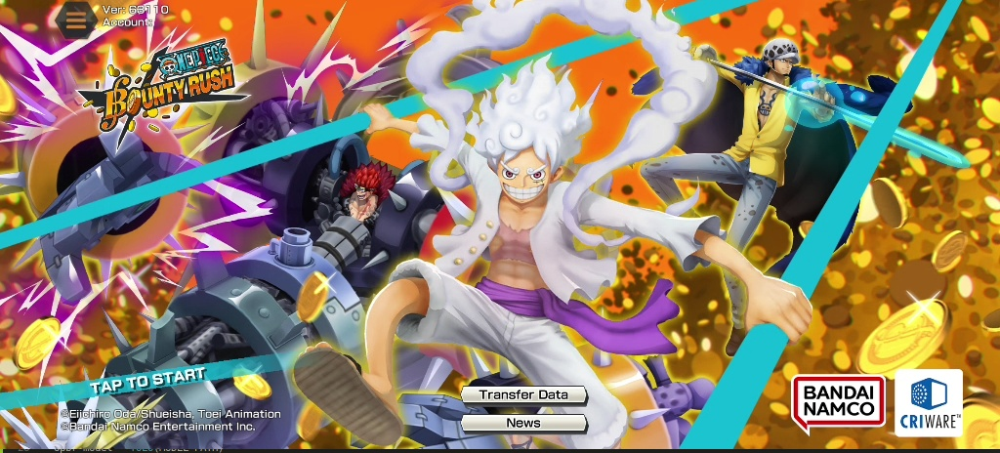


image 1/1 /content/drive/MyDrive/teser/scimage1693729583.8270352.jpeg: 480x1024 1 start_page, 9.0ms
Speed: 2.2ms preprocess, 9.0ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 1024)


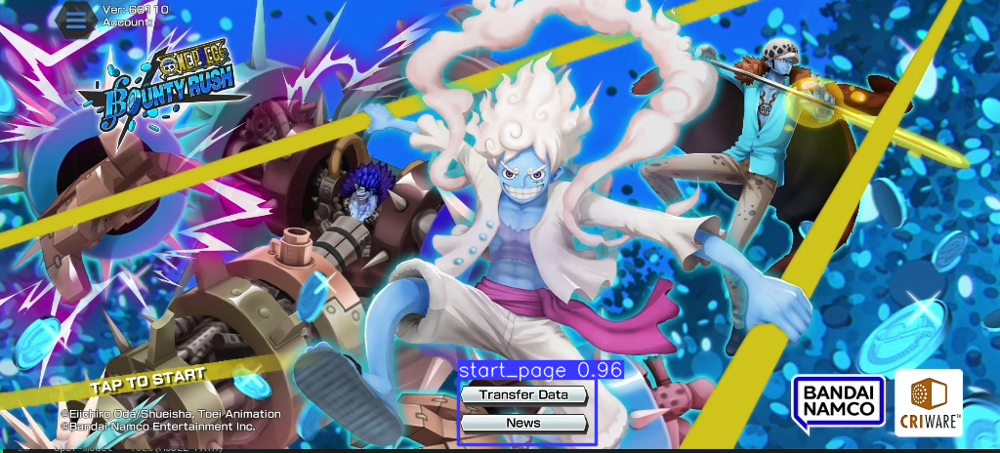

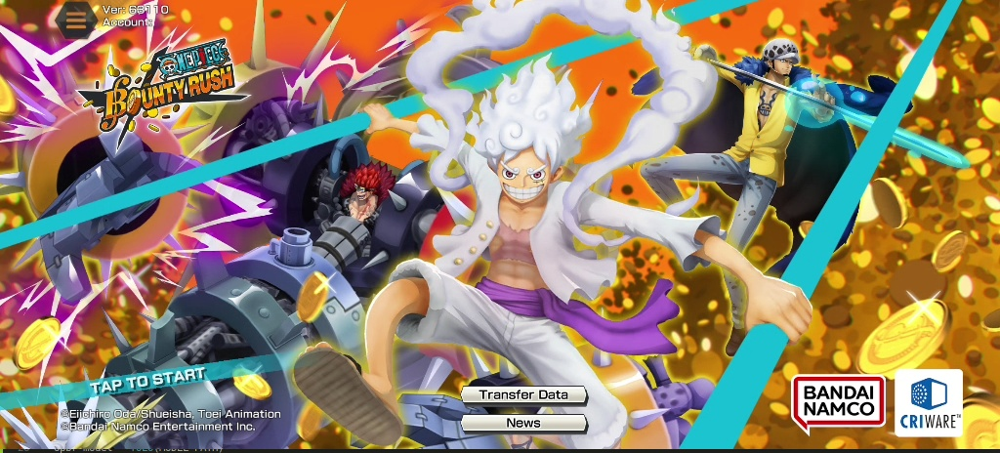


image 1/1 /content/drive/MyDrive/teser/scimage1693729575.4683867.jpeg: 480x1024 1 start_page, 9.4ms
Speed: 2.3ms preprocess, 9.4ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 1024)


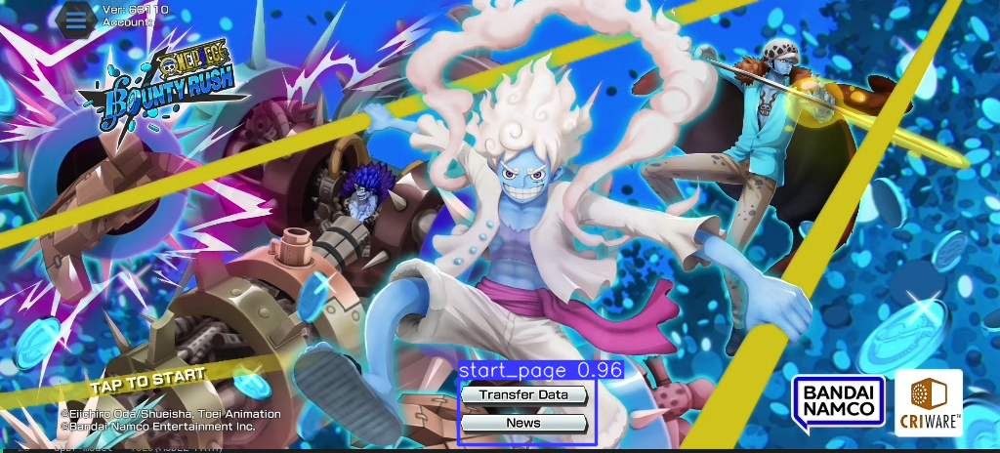

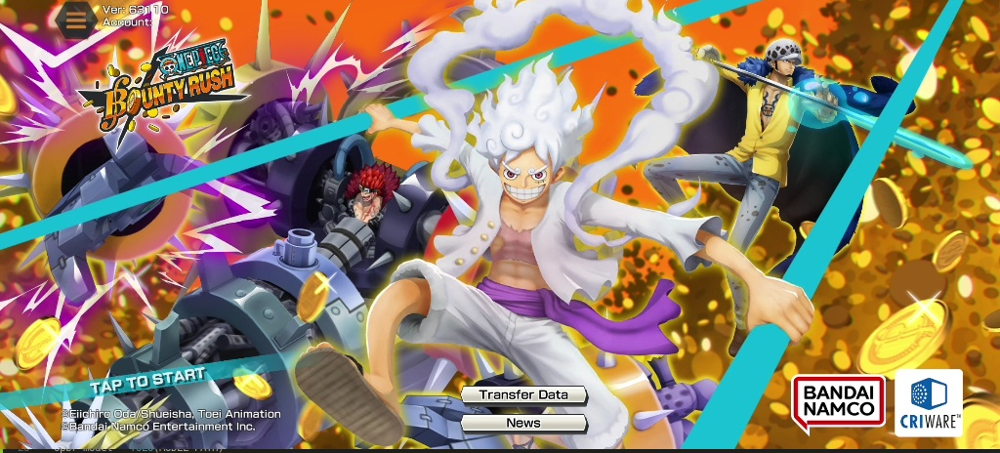


image 1/1 /content/drive/MyDrive/teser/scimage1693729589.676432.jpeg: 480x1024 1 start_page, 11.2ms
Speed: 2.4ms preprocess, 11.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 1024)


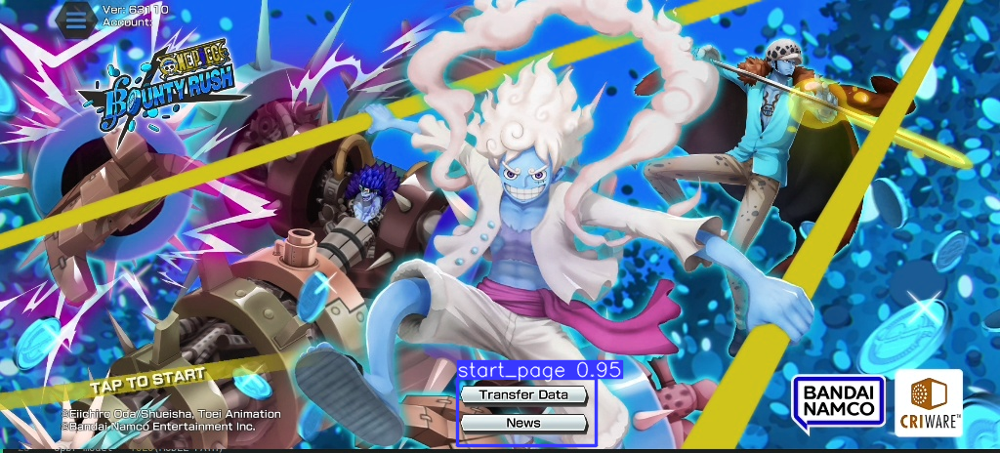

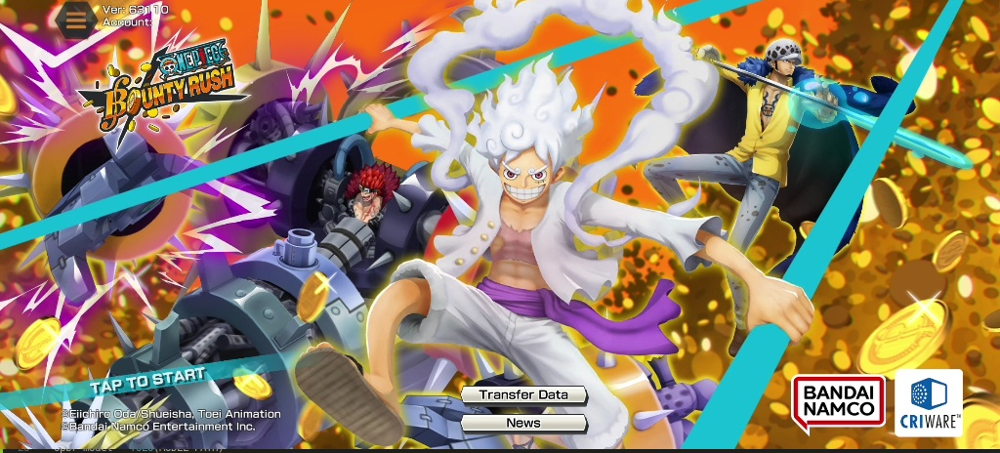


image 1/1 /content/drive/MyDrive/teser/scimage1693729589.676432.jpeg: 480x1024 1 start_page, 8.1ms
Speed: 2.0ms preprocess, 8.1ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 1024)


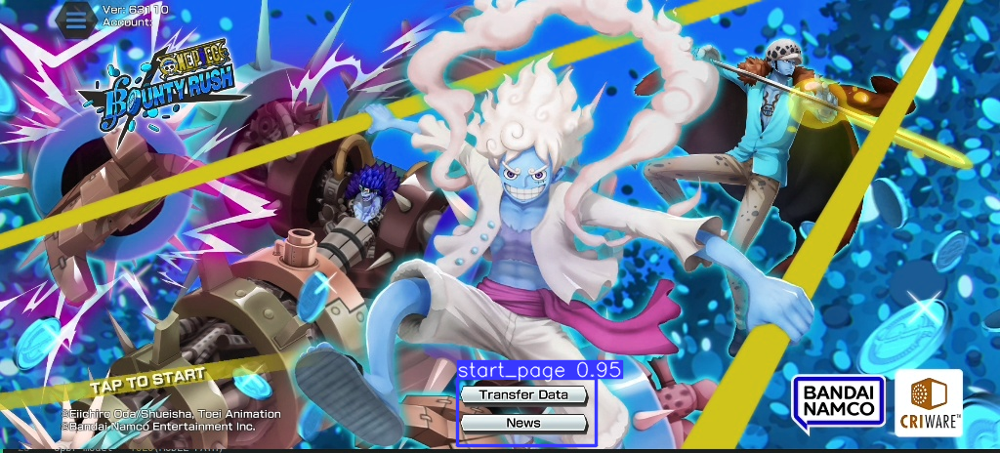

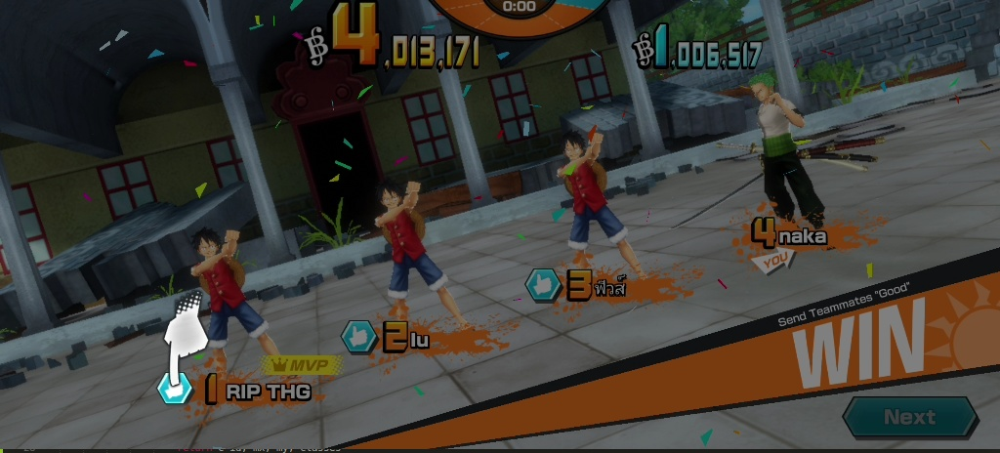


image 1/1 /content/drive/MyDrive/teser/scimage1693730514.21539.jpeg: 480x1024 1 commend, 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 1024)


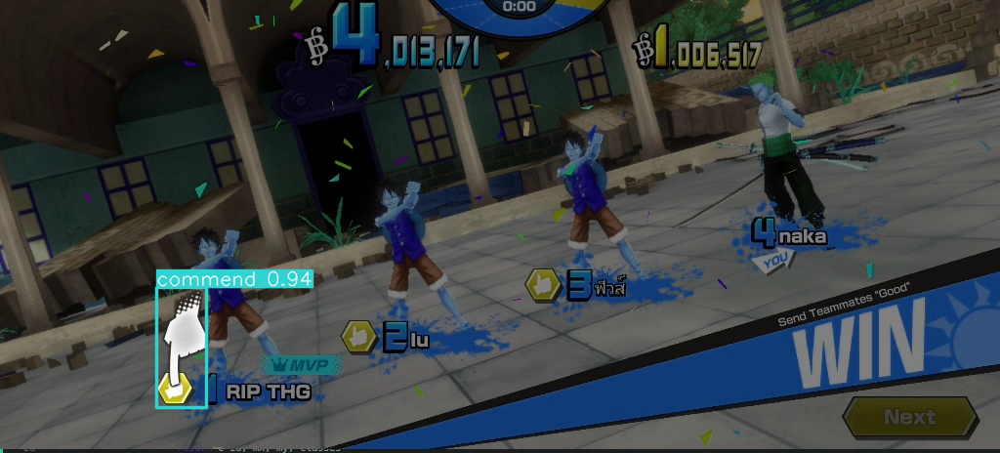

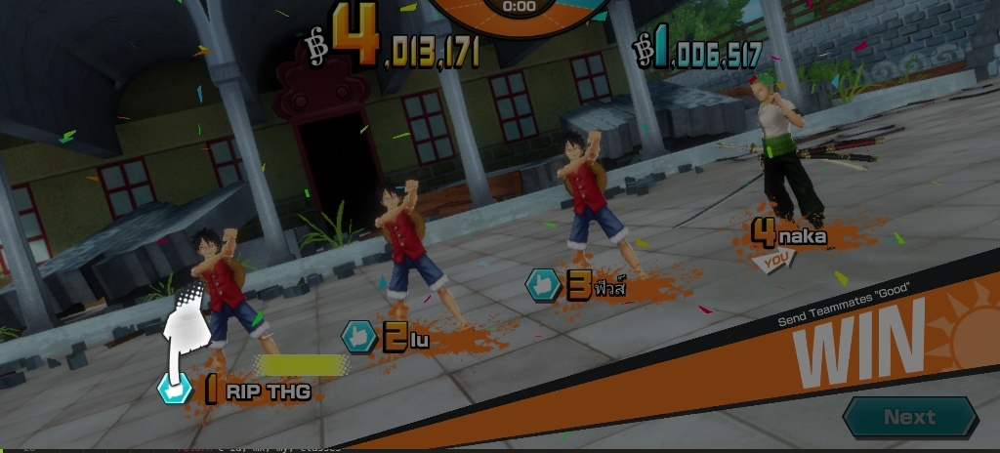


image 1/1 /content/drive/MyDrive/teser/scimage1693730507.6396356.jpeg: 480x1024 1 commend, 8.7ms
Speed: 2.2ms preprocess, 8.7ms inference, 3.0ms postprocess per image at shape (1, 3, 480, 1024)


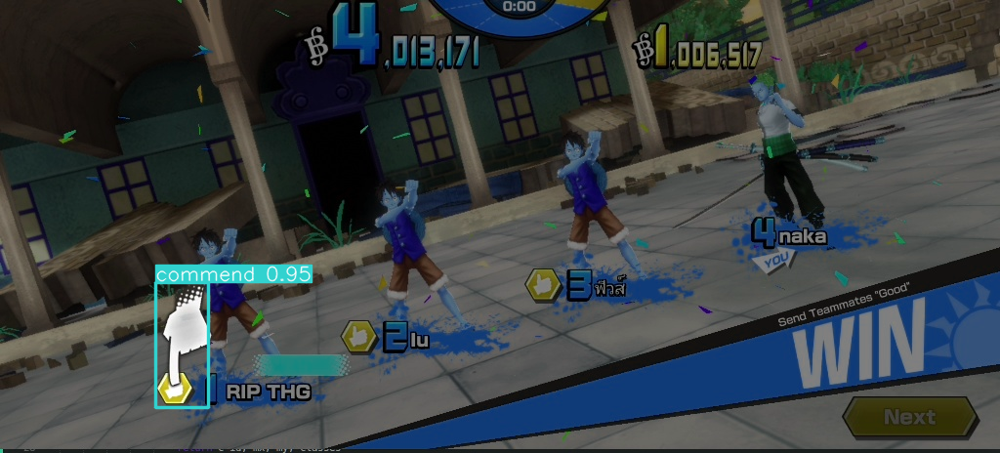

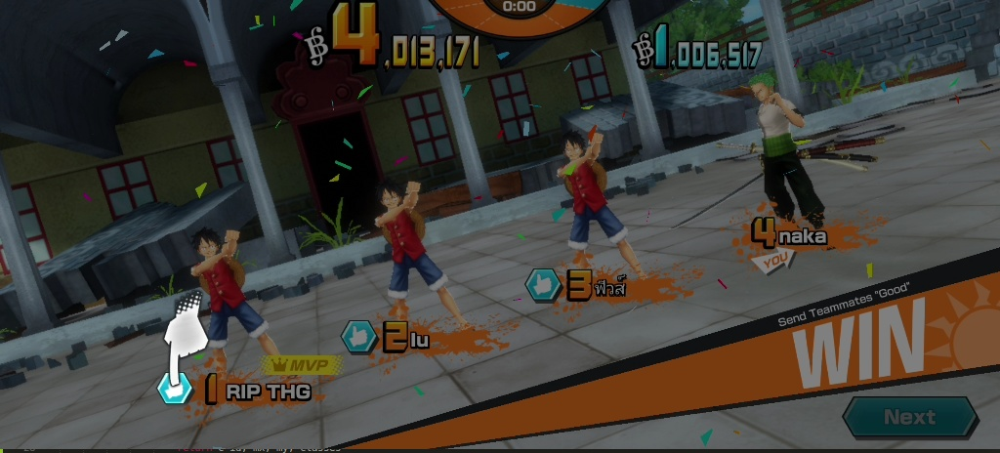


image 1/1 /content/drive/MyDrive/teser/scimage1693730514.21539.jpeg: 480x1024 1 commend, 10.0ms
Speed: 2.2ms preprocess, 10.0ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 1024)


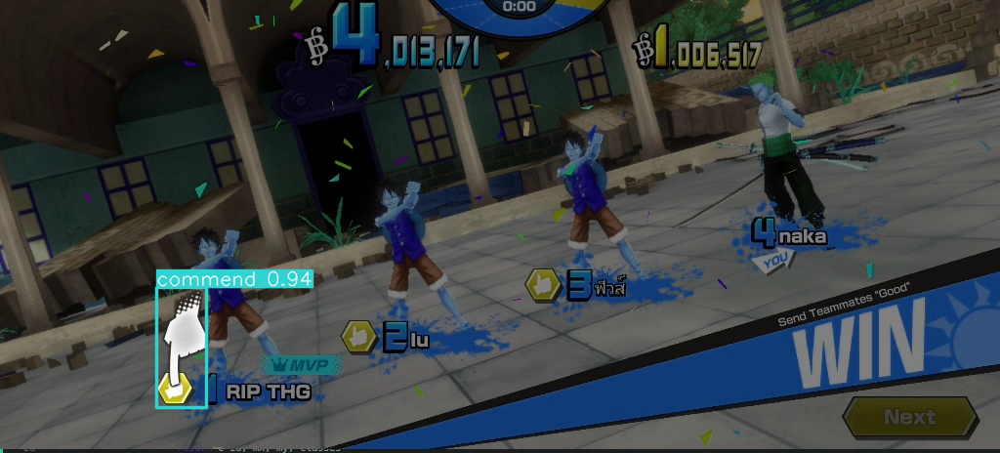

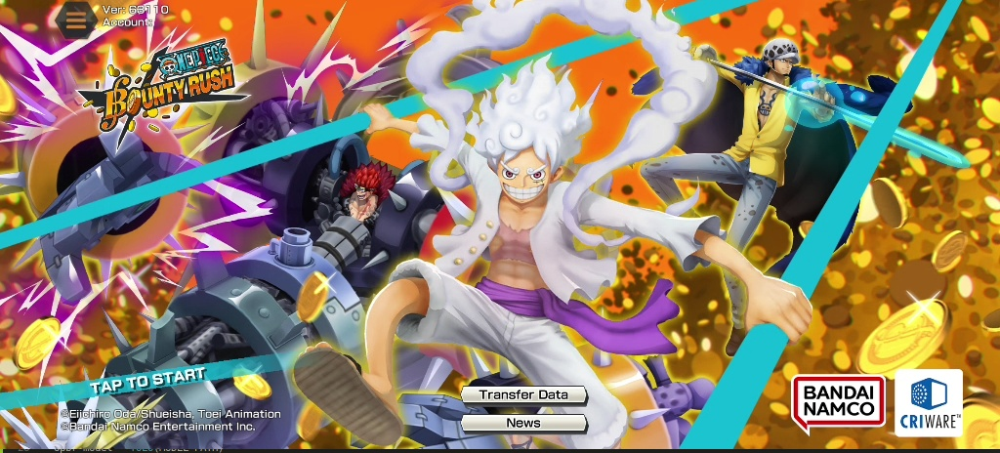


image 1/1 /content/drive/MyDrive/teser/scimage1693729583.8270352.jpeg: 480x1024 1 start_page, 13.2ms
Speed: 1.9ms preprocess, 13.2ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 1024)


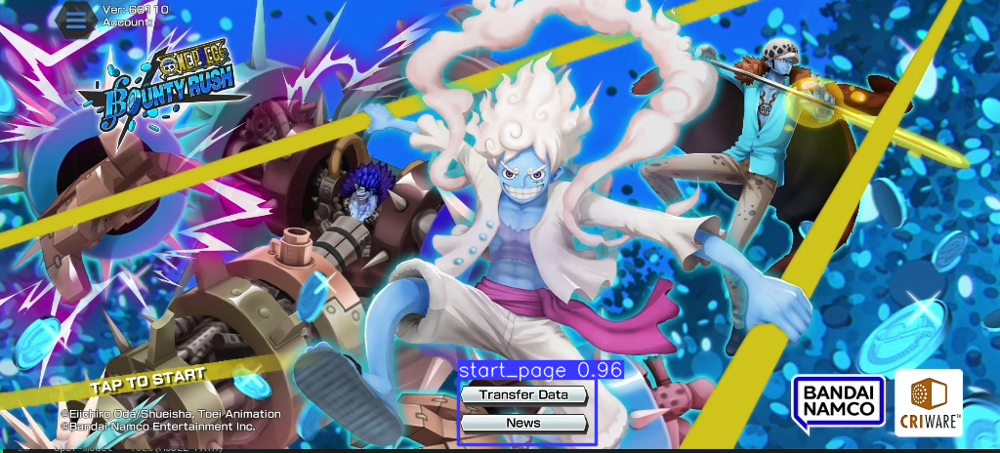

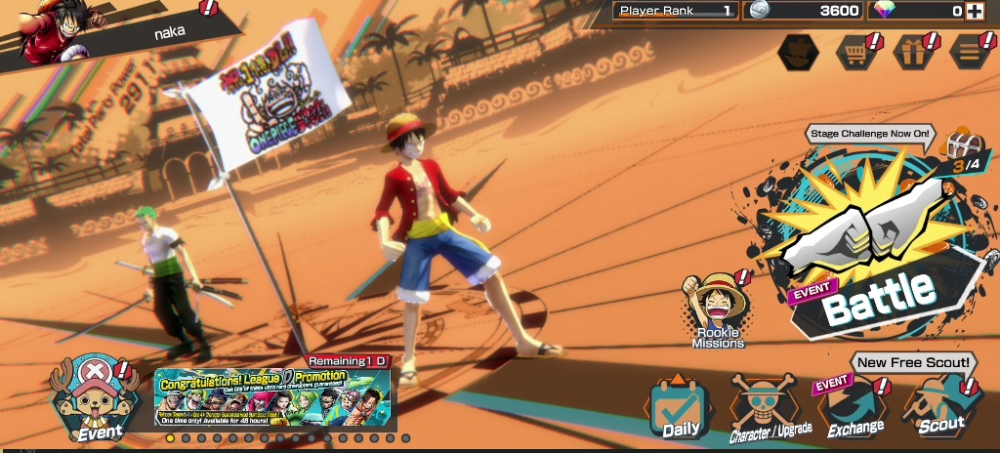


image 1/1 /content/drive/MyDrive/teser/scimage1693730994.9141376.jpeg: 480x1024 1 homescreen, 8.1ms
Speed: 1.9ms preprocess, 8.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 1024)


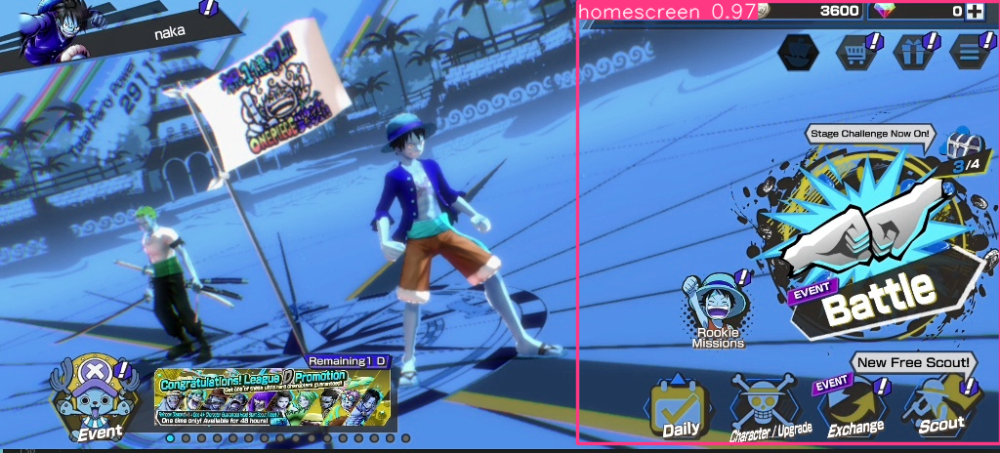

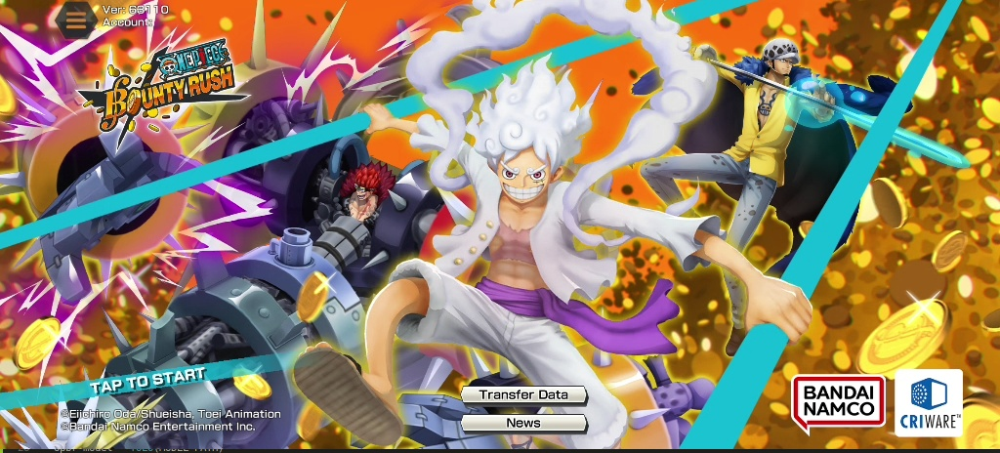


image 1/1 /content/drive/MyDrive/teser/scimage1693729583.8270352.jpeg: 480x1024 1 start_page, 8.2ms
Speed: 2.0ms preprocess, 8.2ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 1024)


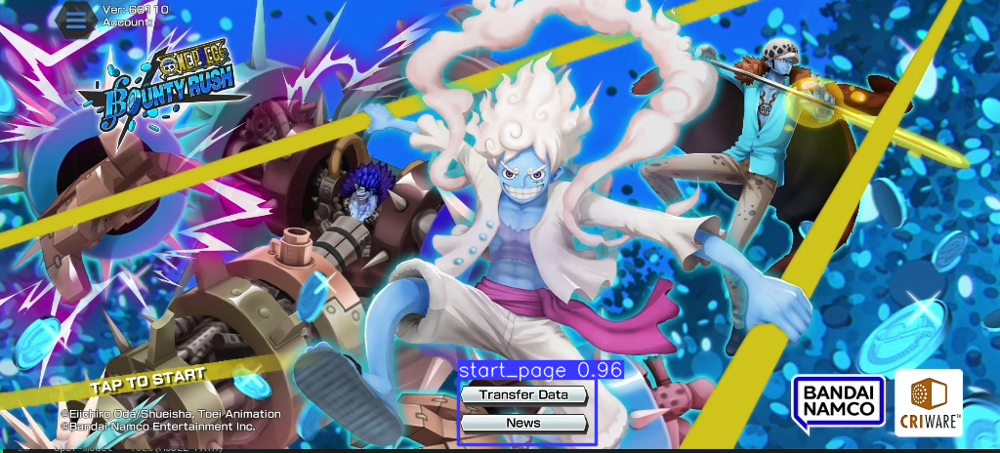

In [ ]:
from IPython.display import display
from PIL import Image
import os
import random

# Assuming you have a list of test file names in 'test_file' and the path to test images in 'test_path'

test_path = "/content/drive/MyDrive/teser/"
test_files = os.listdir(test_path)
test_file = [files for files in test_files if files.endswith(".jpeg")]
  # Replace with the actual path to your test images

pred_files = 10  # Number of random files to process

for _ in range(pred_files):
    random_image_file = random.choice(test_file)
    random_image_file = os.path.join(test_path, random_image_file)

    # Create an Image object and display it
    img = Image.open(random_image_file)
    display(img)

    # Assuming 'opbr_model' is a function that makes predictions on an image
    results = opbr_model(random_image_file)

    for result in results:
        boxes = result.boxes
        probs = result.probs
        speed = result.speed
        classes = result.names
        keypoints = result.keypoints

    for r in results:
        im_array = r.plot()  # Plot a BGR numpy array of predictions
        image = Image.fromarray(im_array)  # Convert to PIL image

        # Display the image
        display(image)

In [ ]:
int(boxes.cls)

0

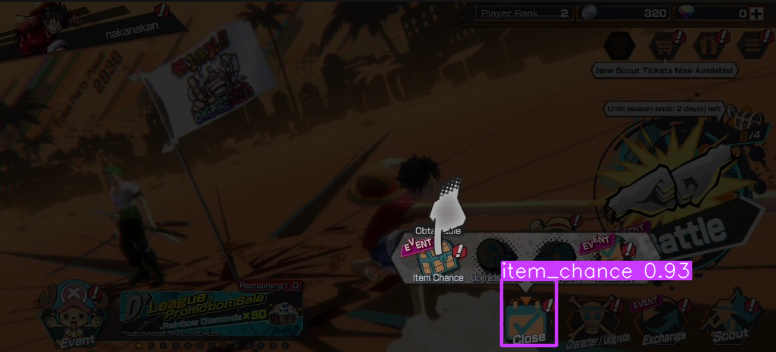

In [ ]:
from PIL import Image

for r in results:
    im_array = r.plot()  # plot a BGR numpy array of predictions
    im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
    from IPython.display import display
display(im)

   # im.save('results.jpg')  # save image

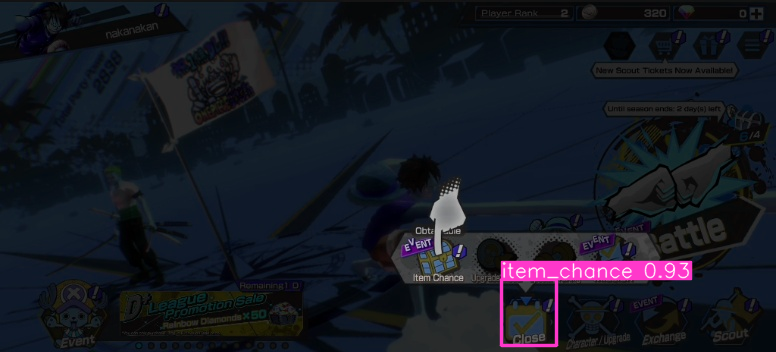

In [ ]:
from PIL import Image
import numpy as np
import IPython.display as display

for r in results:
    im_array = r.plot()  # Assuming r.plot() returns a valid image
    im = Image.fromarray(im_array)
    display.display(im)  # Display the image in Colab


#6) Download

In [ ]:
#@title ## Export to Google Drive or Download training results {display-mode: "form"}

training_results = "Download" #@param ["Export_Google_Drive", "Download"]
#@markdown ---

#@markdown ### Path for saving training results in Google Drive:
GDrive_save_path = "MyDrive/Training_results/YOLOv8"  #@param {type: "string"}

if training_results == "Export_Google_Drive":
  %mkdir -p /content/drive/{GDrive_save_path}
  %cp -ai /content/runs/detect/{train_run_name} /content/drive/{GDrive_save_path}
elif training_results == "Download":
  %cd /content/runs/detect
  !zip -rq {train_run_name}.zip {train_run_name}
  from google.colab import files
  files.download(f"{train_run_name}.zip")

/content/runs/detect


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#7) Important Links

## Links for references and troubleshooting

For image annotation
*   [makesense.ai](https://makesense.ai/)

References
* [Guide for Yolov8 by ultralytics](https://docs.ultralytics.com/modes/) - Important!!
* [Yolov8 - Predict guide](https://docs.ultralytics.com/modes/predict/#working-with-results)
* [insect_detect_ml](https://github.com/maxsitt/insect-detect-ml)
* [depthAI tutorial](https://colab.research.google.com/github/luxonis/depthai-ml-training/blob/master/colab-notebooks/YoloV8_training.ipynb#scrollTo=m_2aqD9EP7BO)

Enhancements
* Yolo model zoo with links [Download links](https://docs.ultralytics.com/models/yolov8/#supported-modes)

* For augmentation, refer and scroll in [Augmentation reference 1](https://github.com/ultralytics/ultralytics/issues/2412) or [Augmentation reference 2](https://github.com/ultralytics/ultralytics/issues/713)

Troubleshooting

* Cuda issues/indexing errors  -> yaml file issues or inconsistency in classes of data


Tidbits

* Make sure there are same amount of image and labels
* Make sure paths and class details are correct in YAML file


#8) General reference

## virtual env
* creation of venv
      python -m venv opbr_bot_env
* activation of venv
      source opbr_bot_env/bin/activate
      if alias set, then open terminate, type alias name
  
* deactivation of venv
      deactivate
* deletion of venv
       rm -r venvname
* creation of alias for venv
      gedit ~/.bashrc
      under custom aliases, edit
      alias workon='cd /home/yami/opbr_bot && source opbr_bot_env/bin/activate'
      alias workoff='deactivate && cd /home/yami'
      save the file
      source ~/.bashrc
*


##Git


1. **initialize your folder**
   `cd` to your working folder and initialize it by using `git init`

2. **Stage Your Changes:**
   Use the `git status` command to see the status of your project. Use `git add` to stage changes that you want to include in your next commit. For example:
   
   ```bash
   git add filename   # To stage a specific file
   git add .          # To stage all changes
   ```

3. **Commit Your Changes:**
   Once you've staged your changes, commit them with a meaningful message using the `git commit` command. A commit message explains what changes you made in this commit.
   
   ```bash
   git commit -m "Add initial files"
   ```

4. **Repeat Steps 2 and 3:**
   Continue editing files, staging changes, and committing them as you progress with your project.

5. **Branching (Optional):**
   If your project becomes more complex or you want to work on new features, consider creating branches using the `git branch` command. Branches allow you to isolate changes and work on them separately. You can create a new branch and switch to it using `git checkout -b new_branch_name`.

6. **Sync with Remote Repository (Optional):**
   If you want to collaborate with others or back up your project, you can connect your local repository to a remote repository (e.g., on GitHub, GitLab). Use `git remote add origin remote_repository_url` to add a remote and then push your changes using `git push`.

7. **Pull Remote Changes (Optional):**
   If you're collaborating with others, use `git pull` to fetch and merge remote changes into your local branch. If you've made changes locally that conflict with the remote changes, you might need to resolve conflicts before committing.

8. **Monitoring Your Progress:**
   You can use commands like `git log` to view the commit history and `git status` to check the current state of your working directory.

Remember, Git is a powerful tool that helps you track changes and collaborate effectively. It's important to commit frequently, write meaningful commit messages, and follow best practices to maintain a clear history of your project's development.